# Очистка набора данных

## Подключение модулей

In [11]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import math
import seaborn as sns


## Вывод данных

In [12]:
df = pd.read_csv('train.csv', low_memory=False)

In [13]:
df.columns.tolist()

['Unnamed: 0',
 'applicant_ethnicity',
 'income',
 'applicant_race_1',
 'applicant_race_2',
 'applicant_race_3',
 'applicant_race_4',
 'applicant_race_5',
 'applicant_sex',
 'co_applicant_ethnicity',
 'co_applicant_race_1',
 'co_applicant_race_2',
 'co_applicant_race_3',
 'co_applicant_race_4',
 'co_applicant_race_5',
 'co_applicant_sex',
 'loan_purpose',
 'loan_type',
 'msamd',
 'preapproval',
 'property_type',
 'purchaser_type',
 'hud_median_family_income',
 'loan_amount',
 'number_of_1_to_4_family_units',
 'number_of_owner_occupied_units',
 'minority_population',
 'population',
 'target']

## Описательная статистика 

Описательная статистика для непрерывных и категориальных признаках отличается.

In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1107611 entries, 0 to 1107610
Data columns (total 29 columns):
 #   Column                          Non-Null Count    Dtype  
---  ------                          --------------    -----  
 0   Unnamed: 0                      1107611 non-null  int64  
 1   applicant_ethnicity             1107611 non-null  int64  
 2   income                          984345 non-null   float64
 3   applicant_race_1                1107376 non-null  float64
 4   applicant_race_2                35442 non-null    float64
 5   applicant_race_3                3369 non-null     float64
 6   applicant_race_4                374 non-null      float64
 7   applicant_race_5                106 non-null      float64
 8   applicant_sex                   1107611 non-null  int64  
 9   co_applicant_ethnicity          1107611 non-null  int64  
 10  co_applicant_race_1             1107523 non-null  float64
 11  co_applicant_race_2             11395 non-null    float64
 12  

In [15]:
df.describe()

,Unnamed: 0,applicant_ethnicity,income,applicant_race_1,applicant_race_2,applicant_race_3,applicant_race_4,applicant_race_5,applicant_sex,co_applicant_ethnicity,...,msamd,preapproval,property_type,purchaser_type,hud_median_family_income,loan_amount,number_of_1_to_4_family_units,number_of_owner_occupied_units,minority_population,population
count,1.107611e+06,1.107611e+06,9.843450e+05,1.107376e+06,35442.000000,3369.000000,374.000000,106.000000,1.107611e+06,1.107611e+06,...,1.107611e+06,1.107611e+06,1.107611e+06,1.107611e+06,1.107611e+06,1.107611e+06,1.107611e+06,1.107611e+06,1.107611e+06,1.107611e+06
mean,5.538050e+05,2.108316e+00,1.550975e+02,5.191629e+00,18.745613,21.102998,23.267380,23.839623,1.738227e+00,3.244078e+00,...,3.569927e+04,1.984494e+00,1.075031e+01,4.782071e+00,7.983755e+04,3.163882e+05,1.830128e+03,1.352884e+03,4.237828e+01,5.368794e+03
std,3.197399e+05,3.718927e-01,3.978920e+03,2.038017e+00,9.490681,10.829949,13.229391,15.244132,9.552362e-01,9.348532e-01,...,1.360452e+04,1.235553e-01,9.274163e+01,1.596073e+01,1.008226e+04,1.385642e+06,9.188345e+02,7.073767e+02,2.493770e+01,2.757590e+03
min,0.000000e+00,1.000000e+00,-6.296000e+03,1.000000e+00,1.000000,1.000000,2.000000,5.000000,1.000000e+00,1.000000e+00,...,0.000000e+00,1.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,5.000000e+03,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,2.769025e+05,2.000000e+00,6.000000e+01,5.000000e+00,5.000000,21.000000,21.000000,5.000000,1.000000e+00,2.000000e+00,...,2.726000e+04,2.000000e+00,3.000000e+00,0.000000e+00,7.950000e+04,1.450000e+05,1.207000e+03,8.620000e+02,2.209000e+01,3.545000e+03
50%,5.538050e+05,2.000000e+00,9.200000e+01,5.000000e+00,21.000000,23.000000,23.000000,23.000000,1.000000e+00,4.000000e+00,...,3.674000e+04,2.000000e+00,3.000000e+00,0.000000e+00,8.210000e+04,2.450000e+05,1.727000e+03,1.273000e+03,3.692000e+01,4.895000e+03
75%,8.307075e+05,2.000000e+00,1.460000e+02,6.000000e+00,23.000000,26.000000,27.000000,41.000000,2.000000e+00,4.000000e+00,...,4.522000e+04,2.000000e+00,3.000000e+00,2.000000e+00,8.450000e+04,3.650000e+05,2.347000e+03,1.731000e+03,5.916000e+01,6.574000e+03
max,1.107610e+06,3.000000e+00,3.690126e+06,4.400000e+01,44.000000,44.000000,44.000000,44.000000,6.000000e+00,4.000000e+00,...,9.999900e+04,2.000000e+00,1.111000e+03,7.200000e+01,9.860000e+04,7.000050e+08,8.233000e+03,6.276000e+03,1.000000e+02,2.278000e+04


In [16]:
df

,Unnamed: 0,applicant_ethnicity,income,applicant_race_1,applicant_race_2,applicant_race_3,applicant_race_4,applicant_race_5,applicant_sex,co_applicant_ethnicity,...,preapproval,property_type,purchaser_type,hud_median_family_income,loan_amount,number_of_1_to_4_family_units,number_of_owner_occupied_units,minority_population,population,target
0,0,2,54.0,5.0,NaN,NaN,NaN,NaN,2,4,...,2,3,0,79500,205000.0,1309,568,45.83,2878,True
1,1,2,168.0,5.0,NaN,NaN,NaN,NaN,1,4,...,2,3,71,67500,215000.0,2919,1296,76.18,6071,True
2,2,2,179.0,5.0,NaN,NaN,NaN,NaN,1,2,...,2,3,1,83200,505000.0,826,594,7.54,1339,True
3,3,2,68.0,5.0,NaN,NaN,NaN,NaN,1,2,...,2,3,2,90400,235000.0,1519,920,22.16,3650,True
4,4,3,49.0,5.0,NaN,NaN,NaN,NaN,1,4,...,2,3,1,73500,245000.0,2201,1736,27.89,6797,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1107606,1107606,2,218.0,5.0,NaN,NaN,NaN,NaN,2,2,...,2,3,0,86100,255000.0,1670,1335,36.88,5019,False
1107607,1107607,2,90.0,5.0,NaN,NaN,NaN,NaN,2,4,...,2,3,0,82100,335000.0,2573,1570,57.53,7344,False
1107608,1107608,2,117.0,5.0,NaN,NaN,NaN,NaN,1,2,...,2,3,0,80100,225000.0,3310,496,59.35,7565,False
1107609,1107609,2,37.0,5.0,NaN,NaN,NaN,NaN,1,4,...,2,3,0,90300,215000.0,922,358,81.23,5536,False


Вывыведем все столбцы которые есть в датасете в виде диаграммы и посмотрим какие значения стоит выбирать 

array([[<AxesSubplot: title={'center': 'Unnamed: 0'}>,
        <AxesSubplot: title={'center': 'applicant_ethnicity'}>,
        <AxesSubplot: title={'center': 'income'}>,
        <AxesSubplot: title={'center': 'applicant_race_1'}>,
        <AxesSubplot: title={'center': 'applicant_race_2'}>],
       [<AxesSubplot: title={'center': 'applicant_race_3'}>,
        <AxesSubplot: title={'center': 'applicant_race_4'}>,
        <AxesSubplot: title={'center': 'applicant_race_5'}>,
        <AxesSubplot: title={'center': 'applicant_sex'}>,
        <AxesSubplot: title={'center': 'co_applicant_ethnicity'}>],
       [<AxesSubplot: title={'center': 'co_applicant_race_1'}>,
        <AxesSubplot: title={'center': 'co_applicant_race_2'}>,
        <AxesSubplot: title={'center': 'co_applicant_race_3'}>,
        <AxesSubplot: title={'center': 'co_applicant_race_4'}>,
        <AxesSubplot: title={'center': 'co_applicant_race_5'}>],
       [<AxesSubplot: title={'center': 'co_applicant_sex'}>,
        <AxesSub

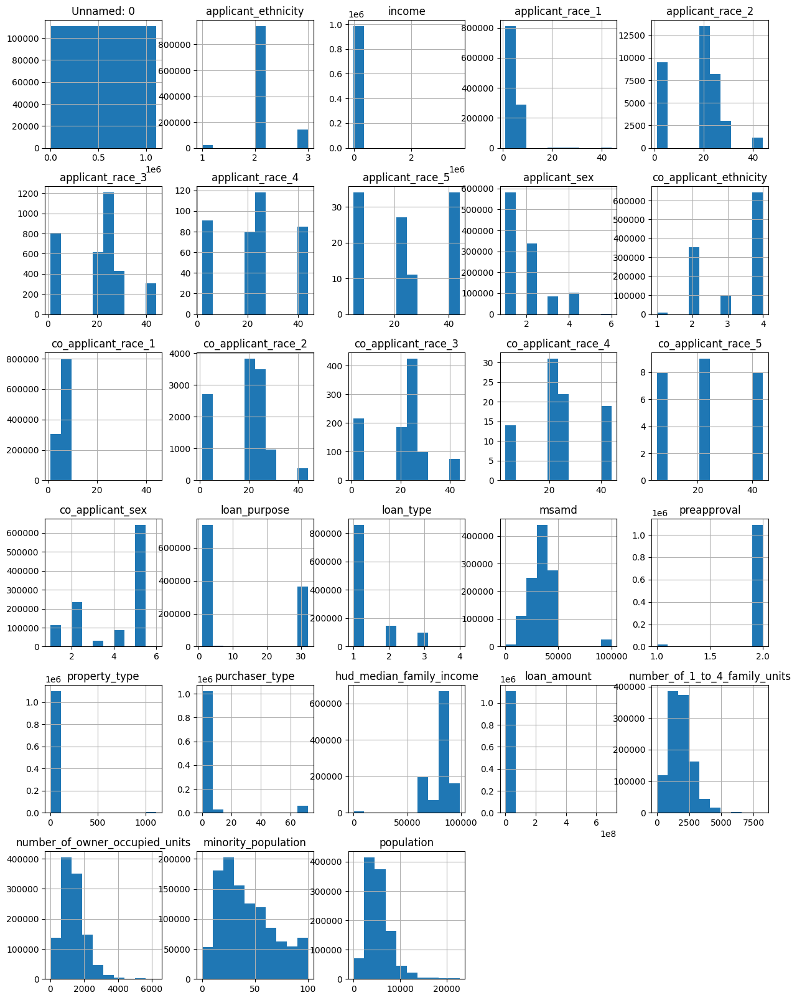

In [17]:
df.hist(figsize=(15,20))

Построим графики зависимости от Таргета значения


In [18]:
import plotly.express as px

In [19]:
px.histogram(
    df,  # датасет
    'income',  # столбец, для которого требуется построить гистограмму
    title='Распределение доходов клиентов',  # название графика
    color='target',  # разделение данных по таргету
)

In [20]:
px.histogram(
    df,  # датасет
    'purchaser_type',  # столбец, для которого требуется построить гистограмму
    title='Распределение по типу покупателя',  # название графика
    color='target',  # разделение данных по таргету
)

In [21]:
px.histogram(
    df,  # датасет
    'msamd',  # столбец, для которого требуется построить гистограмму
    title='Зависимость msa/md от таргета',  # название графика
    color='target',  # разделение данных по таргету
)